Author: Nicolas Legrand <nicolas.legrand@cfin.au.dk>

In [2]:
import numpy as np
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from systole.detection import oxi_peaks, rr_artefacts
from systole.correction import correct_rr
from systole.utils import heart_rate
from systole.hrv import time_domain, frequency_domain, nonlinear
from systole.plotly import plot_raw
import pingouin as pg

In [3]:
parent = os.path.join(os.getcwd(), os.pardir)
path = os.path.join(os.path.abspath(parent), 'Data', 'Raw')
subjects = [f for f in os.listdir(path) if len(f) == 5]
filename = path + '/{nSub}/{nSub}_Aro_{arousal}_Val_{valence}_Learn_{learningTime}_Block_{block}.txt'  # Template for signal files

# Pulse rate variability

In [4]:
final_df = pd.DataFrame([])
for nSub in subjects:
    
    # Import behavioural data
    df = pd.read_csv(os.path.join(path, nSub, 'Subject_{}.txt'.format(nSub)), na_values=['Nan'])

    # Loop through conditions
    fig, axs = plt.subplots(6, 2, figsize=[14, 14])
    axs, i = axs.ravel(), 0
    for val in ['High', 'Low']:
        for aro in ['High', 'Low']:

            for learningTime in [30, 60, 90]:

                # Filter for condition
                this_df = df.copy()[(df.Arousal == aro) & (df.Valence == val) & (df.LearningTime == learningTime)]
                nBlock = this_df.nBlock.iloc[0]  # Get block numbers
                
                # Import pulse oximeter recording
                signal_file = filename.format(nSub=nSub, arousal=aro, valence=val, learningTime=learningTime, block=int(nBlock))
                signal_df = pd.read_csv(signal_file)

                # Find peaks - Remove learning phase
                signal, peaks = oxi_peaks(signal_df.signal[np.where(np.asarray(signal_df.triggers)==2)[0][0]:], noise_removal=False)

                # Convert to RR time series
                rr = np.diff(np.where(peaks)[0])

                # Artefacts removal
                artefacts_correction = correct_rr(rr)

                percent_corrected = round(sum([artefacts_correction[i] for i in ['ectopic', 'long', 'short', 'missed', 'extra']])/len(rr), 4)
                clean_rr = artefacts_correction['clean_rr']

                # Plot RR
                axs[i].plot(np.cumsum(clean_rr)/1000, clean_rr, 'k-')
                axs[i].plot(np.cumsum(clean_rr)/1000, clean_rr, 'wo', markersize=4, markeredgecolor='k')
                axs[i].set_ylim(400, 1400)
                axs[i].set_xlabel('Time (s)')
                axs[i].text(100, 1100, 'Subject: ' + nSub + ', Valence:' + val + ' Arousal: ' + aro + 'Time: ' + str(learningTime))
                
                i += 1

                # HRV indexes
                hrv_time = time_domain(clean_rr)
                hrv_frequency = frequency_domain(clean_rr)
                hrv_nonlinear = nonlinear(clean_rr)

                this_df = hrv_time.append([hrv_frequency, hrv_nonlinear], ignore_index=True)
                this_df['Subject'] = nSub
                this_df['Valence'] = val
                this_df['Arousal'] = aro
                this_df['LearningTime'] = learningTime
                this_df['PercentCorrect'] = percent_corrected
                this_df['Signal_STD'] = signal.std()

                final_df = final_df.append(this_df, sort=False)
    
    plt.tight_layout()

    dirName = os.path.join(os.path.abspath(parent), 'Reports', 'R-R-TimeSeries/')
    plt.savefig(dirName + nSub + '_CleaningRR.png', dpi=300)
    plt.close(fig)

# Rejection

**Drop participants due to bad signal**

In [5]:
reject = ['11141', '11129', '11136', '11137', '47617']

# Create reject vector
final_df['Reject'] = 0
for sub in reject:
    final_df.loc[final_df.Subject == sub, 'Reject'] = 1

# Interactive visualiation

This code snippet can be used to explore interactively the RR time series and check correct artefact rejection.

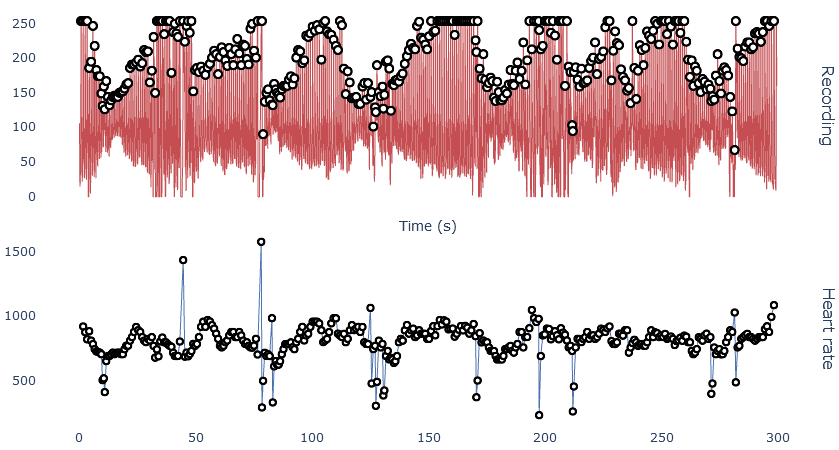

In [8]:
nSub = '11113'
val, aro, learningTime = 'Low', 'Low', 30
    
# Import behavioural data
df = pd.read_csv(os.path.join(path, nSub, 'Subject_{}.txt'.format(nSub)), na_values=['Nan'])

# Filter for condition
df = df.copy()[(df.Arousal == aro) & (df.Valence == val) & (df.LearningTime == learningTime)]
nBlock = df.nBlock.iloc[0]  # Get block numbers

# Import pulse oximeter recording
signal_file = filename.format(nSub=nSub, arousal=aro, valence=val, learningTime=learningTime, block=int(nBlock))
signal_df = pd.read_csv(signal_file)
signal_df['ppg'] = signal_df['signal']

# Remove learning time
signal_df = signal_df[np.where(np.asarray(signal_df.triggers)==2)[0][0]:]

plot_raw(signal_df)

In [9]:
# Reject bad segmaents
bads = [
        ['11113', 'High', 'Low', 30],
        ['11113', 'Low', 'Low', 30],
        ['11113', 'Low', 'Low', 90],
        ['11113', 'High', 'High', 30],
        ['11114', 'Low', 'High', 30],
        ['11118', 'Low', 'High', 90],
        ['11119', 'Low', 'High', 30],
        ['11121', 'Low', 'High', 30],
        ['11121', 'High', 'Low', 30],
        ['11121', 'Low', 'Low', 30],
        ['11121', 'Low', 'High', 90],
        ['11124', 'Low', 'High', 90],
        ['11124', 'Low', 'Low', 30],
        ['11124', 'Low', 'Low', 90],
        ['11125', 'Low', 'Low', 60],
        ['11125', 'Low', 'High', 30],
        ['11126', 'Low', 'High', 30],
        ['11126', 'Low', 'Low', 60],
        ['11126', 'High', 'High', 60],
        ['11132', 'High', 'Low', 60],
        ['11132', 'Low', 'Low', 30],
        ['11132', 'Low', 'Low', 60],
        ['11133', 'High', 'Low', 30],
        ['11133', 'Low', 'High', 90],
        ['11135', 'Low', 'Low', 30],
        ['11135', 'High', 'High', 60],
        ['11138', 'High', 'Low', 30],
        ['11138', 'High', 'High', 60],
        ['11138', 'Low', 'High', 30],
        ['11138', 'Low', 'Low', 60],
        ['11140', 'High', 'Low', 90],
        ['11140', 'Low', 'Hig', 90],
        ['43336', 'High', 'Low', 30],
        ['43336', 'Low', 'Low', 90],
        ['43336', 'High', 'High', 30],
        ['47203', 'Low', 'High', 90],
        ['47203', 'Low', 'Low', 90],
        ['47284', 'Low', 'High', 90],
        ['47284', 'High', 'Low', 90],
        ['47284', 'Low', 'Low', 60],
        ['47284', 'Low', 'Low', 90],
        ['47542', 'Low', 'High', 60],
        ['47542', 'High', 'Low', 60],
        ['47617', 'High', 'Low', 30],
       ]

for bad in bads:
    final_df.loc[(final_df.Subject == bad[0]) & (final_df.Valence == bad[1]) & (final_df.Arousal == bad[2]) & (final_df.Subject == bad[3]), 'Reject'] = 1

In [10]:
final_df = final_df[final_df.Reject!=1]

In [11]:
# Average across learning time
final_df = final_df.groupby(['Subject', 'Valence', 'Arousal', 'Metric'], as_index=False).mean()

In [12]:
final_df.to_csv(os.path.join(os.path.abspath(parent), 'Data', 'Preprocessed', 'hrv.txt'))

Save as JASP format

In [13]:
jasp_df = []
for metric in ['MeanBPM', 'pover_hf_nu', 'pover_lf_nu', 'RMSSD', 'SD1', 'SD2', 'hf_peak', 'lf_peak', 'pnn50']:
    this_df = final_df.copy()[final_df.Metric==metric].pivot_table(index='Subject', columns=['Valence', 'Arousal'], values='Values').reset_index()
    cols = ['Subject']
    cols.extend([''.join((metric + '_', col[1], '_Aro_', col[0], 'Val')) for col in this_df.columns[1:]])
    this_df.columns = cols
    jasp_df.append(this_df)
jasp_df = pd.concat(jasp_df, axis=1)
jasp_df = jasp_df.loc[:,~jasp_df.columns.duplicated()]
jasp_df.to_csv(os.path.join(os.path.abspath(parent), 'Data', 'Preprocessed', 'JASP', 'hrv.txt'))

The statistical analyses reported in the paper are carried out using JASP, based on the data frames saved in the previous step. Here, we provide code snippets for interactive visualization and testing directly inside Binder. Although the results may slightly differ due to the statistical software used, no major difference are observed.

# Plot

In [14]:
final_df = pd.read_csv(os.path.join(os.path.abspath(parent), 'Data', 'Preprocessed', 'hrv.txt'))

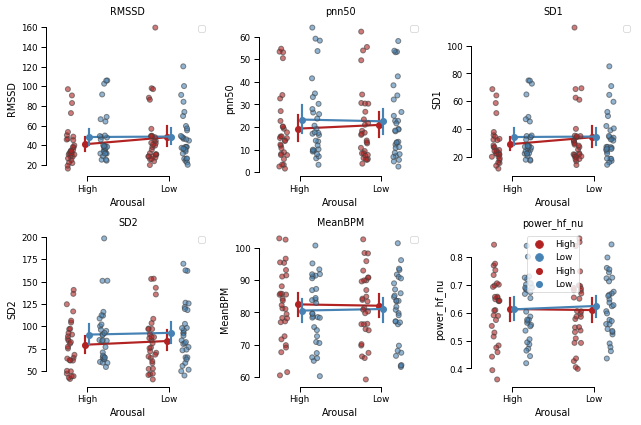

In [15]:
sns.set_context('paper')
fig, axs = plt.subplots(2, 3, figsize=(9, 6))
axs = axs.ravel()
aov, posthoc = [], []
for i, metric in enumerate(['RMSSD', 'pnn50', 'SD1', 'SD2', 'MeanBPM', 'power_hf_nu']):
    this_df = final_df[(final_df.Metric==metric)].groupby(['Subject', 'Valence', 'Arousal'], as_index=False).mean()

    aov.append(pg.rm_anova(data=this_df, subject='Subject', within=['Valence', 'Arousal'], dv='Values'))
    posthoc.append(pg.pairwise_ttests(data=this_df, subject='Subject', within=['Arousal', 'Valence'], dv='Values', effsize='cohen'))

    sns.stripplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs[i], palette=['firebrick', 'steelblue'], linewidth=1, dodge=True, alpha=.6)
    sns.pointplot(data=this_df, x='Arousal', y='Values', hue='Valence', ax=axs[i], palette=['firebrick', 'steelblue'], dodge=True)
    axs[i].set_title(metric)
    axs[i].set_ylabel(metric)
    axs[i].legend([])
plt.legend(loc='best')
plt.tight_layout()
sns.despine(trim=10)

# Statistics

## RMSSD

In [16]:
aov[0]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,489.109481,1,29,489.109481,6.739810,0.014648,0.014648,0.188580,1.0
1,Arousal,423.927490,1,29,423.927490,2.993147,0.094248,0.094248,0.093556,1.0
2,Valence * Arousal,322.905085,1,29,322.905085,2.304867,0.139797,0.139797,0.073626,1.0


In [17]:
posthoc[0]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-1.730071,29.0,two-sided,0.094248,0.731,-0.157811
1,Valence,-,High,Low,True,True,-2.596114,29.0,two-sided,0.014648,3.266,-0.172149
2,Arousal * Valence,High,High,Low,True,True,-4.141429,29.0,two-sided,0.000272,105.449,-0.328733
3,Arousal * Valence,Low,High,Low,True,True,-0.227676,29.0,two-sided,0.821496,0.199,-0.027725


## pnn50

In [18]:
aov[1]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,236.873633,1,29,236.873633,24.170730,0.000032,0.000032,0.454587,1.0
1,Arousal,5.649233,1,29,5.649233,0.816280,0.373714,0.373714,0.027377,1.0
2,Valence * Arousal,44.436727,1,29,44.436727,4.540535,0.041706,0.041706,0.135375,1.0


In [19]:
posthoc[1]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-0.903482,29.0,two-sided,0.373714,0.283,-0.026940
1,Valence,-,High,Low,True,True,-4.916374,29.0,two-sided,0.000032,729.478,-0.174208
2,Arousal * Valence,High,High,Low,True,True,-6.102146,29.0,two-sided,0.000001,1.485e+04,-0.246943
3,Arousal * Valence,Low,High,Low,True,True,-1.707492,29.0,two-sided,0.098417,0.707,-0.098265


## SD1

In [20]:
aov[2]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,245.387114,1,29,245.387114,6.739734,0.014648,0.014648,0.188578,1.0
1,Arousal,212.642507,1,29,212.642507,2.992990,0.094257,0.094257,0.093551,1.0
2,Valence * Arousal,162.063161,1,29,162.063161,2.306457,0.139665,0.139665,0.073674,1.0


In [21]:
posthoc[2]

,Contrast,Arousal,A,B,Paired,Parametric,T,dof,Tail,p-unc,BF10,cohen
0,Arousal,-,High,Low,True,True,-1.730026,29.0,two-sided,0.094257,0.731,-0.157775
1,Valence,-,High,Low,True,True,-2.596100,29.0,two-sided,0.014648,3.266,-0.172125
2,Arousal * Valence,High,High,Low,True,True,-4.143400,29.0,two-sided,0.000271,105.959,-0.328709
3,Arousal * Valence,Low,High,Low,True,True,-0.227494,29.0,two-sided,0.821636,0.199,-0.027700


## SD2

In [22]:
aov[3]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,3182.769491,1,29,3182.769491,35.202705,0.000002,0.000002,0.548306,1.0
1,Arousal,277.951426,1,29,277.951426,2.024228,0.165476,0.165476,0.065247,1.0
2,Valence * Arousal,36.082689,1,29,36.082689,0.253667,0.618309,0.618309,0.008671,1.0


## BPM

In [23]:
aov[4]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,65.712000,1,29,65.712000,10.851501,0.002606,0.002606,0.272298,1.0
1,Arousal,0.030083,1,29,0.030083,0.016830,0.897675,0.897675,0.000580,1.0
2,Valence * Arousal,6.256333,1,29,6.256333,2.339481,0.136968,0.136968,0.074650,1.0


## HF-HRV

In [24]:
aov[5]

,Source,SS,ddof1,ddof2,MS,F,p-unc,p-GG-corr,np2,eps
0,Valence,0.001395,1,29,0.001395,0.316270,0.578179,0.578179,0.010788,1.0
1,Arousal,0.000522,1,29,0.000522,0.235447,0.631160,0.631160,0.008053,1.0
2,Valence * Arousal,0.001877,1,29,0.001877,0.541011,0.467922,0.467922,0.018314,1.0
